In [34]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sb
import plotly.offline as py

%matplotlib inline

In [35]:
from keras.datasets import cifar10
(x_train, y_train), (x_test, y_test) = cifar10.load_data()

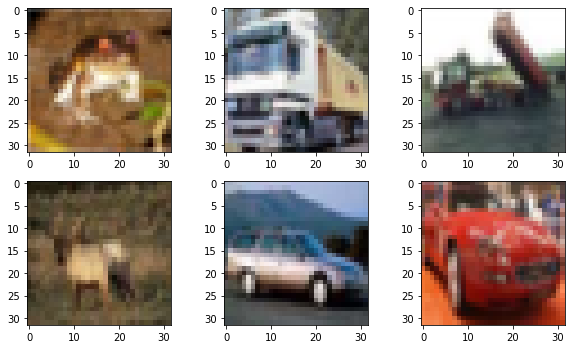

In [36]:
x_train = x_train/255.0
X_train = x_train.reshape(len(x_train),-1)
# Plot image data from x_train
plt.figure(figsize = (10,9))
for i in range(6):
    plt.subplot(3,3,i+1)
    plt.imshow(x_train[i])

In [37]:
print(x_train.shape)
print(X_train.shape)

(50000, 32, 32, 3)
(50000, 3072)


In [38]:
def PCA(X ,num_components,variant):
     
    #Step-1
    X_meaned = X - np.mean(X , axis = 0)
     
    #Step-2
    cov_mat = np.cov(X_meaned , rowvar = False)
     
    #Step-3
    eigen_values , eigen_vectors = np.linalg.eigh(cov_mat)
     
    #Step-4
    sorted_index = np.argsort(eigen_values)[::-1]
    sorted_eigenvalue = eigen_values[sorted_index]
    sorted_eigenvectors = eigen_vectors[:,sorted_index]
    
    #Step-5
    eigenvector_subset = sorted_eigenvectors[:,variant:variant+num_components]
    
    #Step-6
    X_reduced = np.dot(eigenvector_subset.transpose() , X_meaned.transpose() ).transpose()
     
    return X_reduced,eigenvector_subset.transpose()

In [39]:
def class_target(y):
    d = {'Classe':list(y)}
    dfs = pd.DataFrame(d)
    dfs.Classe=dfs.Classe.astype(int)
    target = dfs.iloc[:,0]
    return target

In [40]:
def plotPCA_2D(principal_df,num):
    plt.figure(figsize = (10,10))
    sb.scatterplot(data = principal_df , x = 'PC1',y = 'PC2', hue = 'Classe' , s = 60 , palette= 'icefire')
    plt.title('Example N° : ' +num )

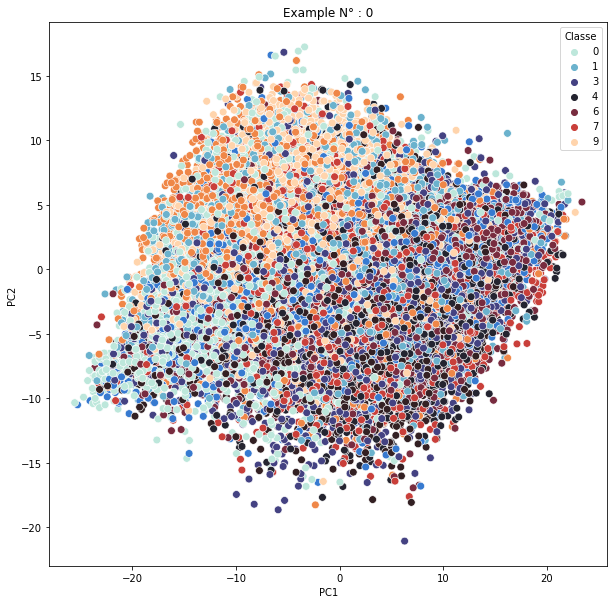

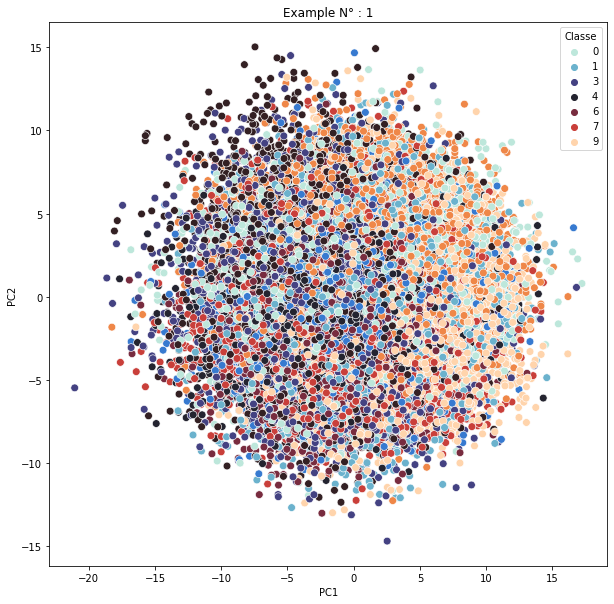

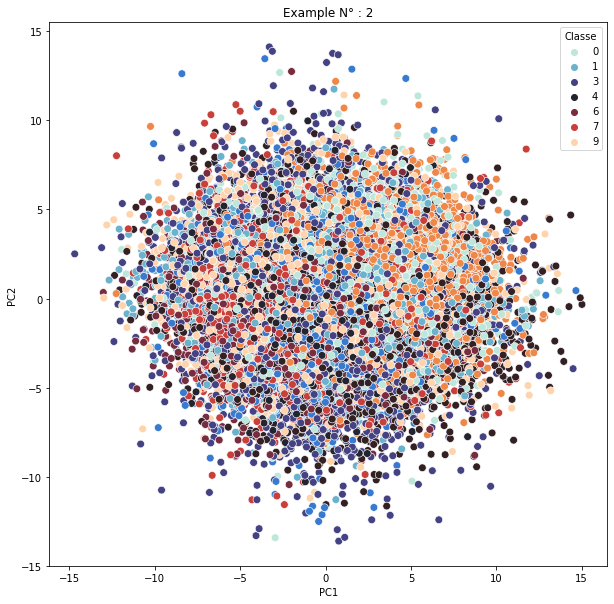

In [41]:
n_components=2
X=X_train
for i in range(0,3):
    variant = i
    mat_reduced,com= PCA(X ,n_components,variant)
    target=class_target(y_train)
    principal_df = pd.DataFrame(mat_reduced , columns = ['PC1','PC2'])
    principal_df = pd.concat([principal_df , pd.DataFrame(target)] , axis = 1)
    plotPCA_2D(principal_df,str(i))

## n_components = 3    -    3D

In [42]:
def plot_pca_3d(points, out):
    scatter = {
        'mode':"markers",
        'name': "y",
        'type': "scatter3d",    
        'x': points[:,0], 
        'y': points[:,1], 
        'z': points[:,2],
        'marker': {'size':2, 'color':out, 'colorscale':'Rainbow'}
    }
    fig = {'data':[scatter], 'layout': {'title':"***"}}
    py.iplot(fig)

In [43]:
n_components=3
for i in range(0,3):
    variant = i
    mat_reduced,com = PCA(X ,n_components,variant)
    target=class_target(y_train)
    Y_pca = target
    plot_pca_3d(mat_reduced, Y_pca)

In [ ]:
## génération

In [55]:
mat_reduced,com= PCA(X ,2,0)

In [56]:
com.shape

(2, 3072)

In [57]:
mat_reduced.shape

(50000, 2)

(32, 32, 3)


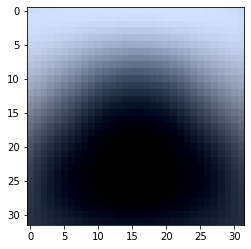

In [61]:
data_original = np.dot(mat_reduced, com)
temp = np.reshape(data_original[0], (32,32,3))
print (temp.shape)
temp = temp/np.amin(temp)
T = np.clip(temp, 0, 1)
plt.imshow(T)

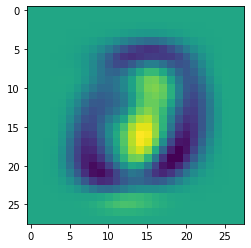

In [152]:
plt.imshow(temp)

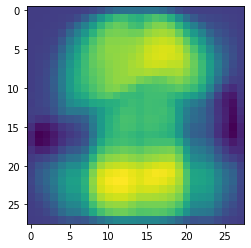

In [91]:
plt.imshow(temp)

In [134]:
data_reduced = np.dot(X_train, pca.components_.T[:,:2])
data_original = np.dot(data_reduced, pca.components_[:2, :])
#data_original=(data_original * 255).astype(np.uint8)
temp = np.reshape(data_original[1], (32,32,3))
#temp=np.array(temp,np.int32)
print (temp.shape)

(32, 32, 3)


(28, 28)


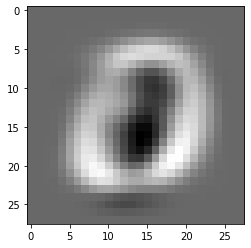

In [211]:
plt.imshow(temp)
print(temp.shape)
plt.imshow(temp, cmap='gray_r')


1.0
-1.440374057979929


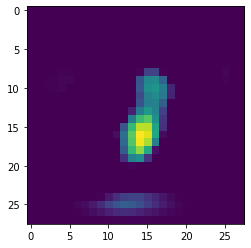

In [209]:
maxValue = np.amax(temp)
minValue = np.amin(temp)
print(maxValue)
print(minValue)
T = np.clip(temp, 0, 1)
plt.imshow(T)

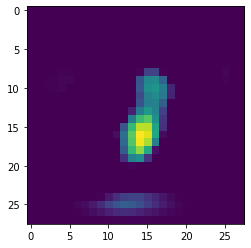

In [208]:
temp = temp/np.amax(temp)
T = np.clip(temp, 0, 1)
plt.imshow(T)

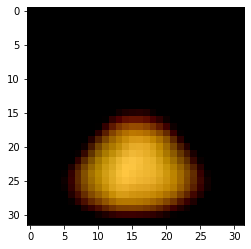